In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import datetime as dt
import seaborn as sns
import plotly.express as px


In [2]:
electric_power_df= pd.read_csv(r"C:\Users\amrsa\Downloads\2023_ElectricPower_15min.csv")
electric_power_df

,Time,Warmtenet,Warmtepomp,Waterzuivering,Vacuum,Laadpalen,Overig,Total,Total for simulation,Total measured
0,2023-01-01 00:00:00,2200.000,14633.333,13326.667,886.667,0.0,686.667,31733.333,16413.333,33366.667
1,2023-01-01 00:15:00,2200.000,14813.333,12766.667,306.667,0.0,513.333,30600.000,15273.333,32206.667
2,2023-01-01 00:30:00,2200.000,14900.000,12560.000,1280.000,0.0,740.000,31680.000,16040.000,33426.667
3,2023-01-01 00:45:00,2200.000,14833.333,12446.667,300.000,0.0,766.667,30546.667,14946.667,32206.667
4,2023-01-01 01:00:00,2200.000,14686.667,12873.333,1406.667,0.0,626.667,31793.333,16480.000,33413.333
...,...,...,...,...,...,...,...,...,...,...
35035,2023-12-31 22:45:00,1646.667,200.000,12033.333,1153.333,0.0,173.333,15206.667,14833.333,17760.000
35036,2023-12-31 23:00:00,1640.000,200.000,12273.333,880.000,0.0,206.667,15200.000,14793.333,17793.333
35037,2023-12-31 23:15:00,1626.667,200.000,11940.000,1133.333,0.0,226.667,15126.667,14700.000,17700.000
35038,2023-12-31 23:30:00,1653.333,200.000,11733.333,753.333,0.0,213.333,14553.333,14140.000,17073.333


In [3]:
electric_power_df['Time'] = pd.to_datetime(electric_power_df['Time'])


# Meta Data

Warmtenet: electricity consumption of the district heating network

Warmtepomp: electricity demand of the heat pump; would be interesting to see if there are patterns in this one (day-night, summer-winter, weekdays-weekends)

Waterzuivering: electricity demand of the waste water treatment

Vacuum: electricity demand of the vacuum system

Laadpalen: charging stations electricity demand, would be nice to be able to predict this

Overig: some residual electricity demand of smaller consumers

Total: sum of electricity demands, you can ignore this column

Total for simulation: another kind of sum of electricity demands, you can ignore this as well

Total measured: total measured electricity demand, this is the one we are most interested in to predict.

In [4]:
electric_power_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35040 entries, 0 to 35039
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Time                  35040 non-null  datetime64[ns]
 1   Warmtenet             33085 non-null  float64       
 2   Warmtepomp            33085 non-null  float64       
 3   Waterzuivering        33085 non-null  float64       
 4   Vacuum                33085 non-null  float64       
 5   Laadpalen             33085 non-null  float64       
 6   Overig                33085 non-null  float64       
 7   Total                 33085 non-null  float64       
 8   Total for simulation  33085 non-null  float64       
 9   Total measured        33085 non-null  float64       
dtypes: datetime64[ns](1), float64(9)
memory usage: 2.7 MB


In [5]:
nan_rows = electric_power_df[electric_power_df.isna().any(axis=1)]
print(nan_rows)

                     Time  Warmtenet  Warmtepomp  Waterzuivering  Vacuum  \
446   2023-01-05 15:30:00        NaN         NaN             NaN     NaN   
447   2023-01-05 15:45:00        NaN         NaN             NaN     NaN   
448   2023-01-05 16:00:00        NaN         NaN             NaN     NaN   
449   2023-01-05 16:15:00        NaN         NaN             NaN     NaN   
450   2023-01-05 16:30:00        NaN         NaN             NaN     NaN   
...                   ...        ...         ...             ...     ...   
32666 2023-12-07 06:30:00        NaN         NaN             NaN     NaN   
32667 2023-12-07 06:45:00        NaN         NaN             NaN     NaN   
32668 2023-12-07 07:00:00        NaN         NaN             NaN     NaN   
32669 2023-12-07 07:15:00        NaN         NaN             NaN     NaN   
32670 2023-12-07 07:30:00        NaN         NaN             NaN     NaN   

       Laadpalen  Overig  Total  Total for simulation  Total measured  
446          Na

In [6]:
nan_percentage = 100 * nan_rows.shape[0] / len(electric_power_df)
print(f"Percentage of rows with NaN: {nan_percentage:.2f}%")


Percentage of rows with NaN: 5.58%


In [7]:
electric_power_df.dropna(inplace=True)
electric_power_df.isna().sum()

Time                    0
Warmtenet               0
Warmtepomp              0
Waterzuivering          0
Vacuum                  0
Laadpalen               0
Overig                  0
Total                   0
Total for simulation    0
Total measured          0
dtype: int64

# feature Engineering


In [8]:

electric_power_df['hour'] = electric_power_df['Time'].dt.hour
electric_power_df['day_of_week'] = electric_power_df['Time'].dt.day_name()
electric_power_df['is_weekend'] = (electric_power_df['day_of_week'] == 'Saturday') | (electric_power_df['day_of_week'] == 'Sunday')
electric_power_df['month'] = electric_power_df['Time'].dt.month


In [9]:

def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Fall'

electric_power_df['season'] = electric_power_df['month'].apply(get_season)

In [10]:
# Lag features like in SQL

electric_power_df['prev_hour_demand'] = electric_power_df['Total measured'].shift(1)
electric_power_df['prev_day_demand'] = electric_power_df.groupby('hour')['Total measured'].shift(96) 
# 96 = 24 hours * 4 (15-minute intervals)



In [11]:
# Calculate rolling statistics

electric_power_df['rolling_mean_3h'] = electric_power_df['Total measured'].rolling(window=12, min_periods=1).mean() 
electric_power_df['rolling_std_3h'] = electric_power_df['Total measured'].rolling(window=12, min_periods=1).std()
# 12 = 3 hours * 4

electric_power_df['rolling_mean_7d'] = electric_power_df['Total measured'].rolling(window=672, min_periods=1).mean() 
electric_power_df['rolling_std_7d'] = electric_power_df['Total measured'].rolling(window=672, min_periods=1).std()
# 672 = 7 days * 96


In [12]:
electric_power_df.sample(5)

,Time,Warmtenet,Warmtepomp,Waterzuivering,Vacuum,Laadpalen,Overig,Total,Total for simulation,Total measured,...,day_of_week,is_weekend,month,season,prev_hour_demand,prev_day_demand,rolling_mean_3h,rolling_std_3h,rolling_mean_7d,rolling_std_7d
9188,2023-04-06 18:00:00,1173.333,293.333,9826.667,860.000,12733.333,200.000,25086.667,24593.333,27566.667,...,Thursday,False,4,Spring,30320.000,45846.667,39711.111167,18387.504157,25430.864741,15270.058204
10697,2023-04-22 11:15:00,1060.000,26240.000,17366.667,1380.000,11880.000,613.333,58540.000,31686.667,62140.000,...,Saturday,True,4,Spring,56126.667,24786.667,41849.603083,15284.113210,25284.131244,14377.290320
4970,2023-02-21 18:30:00,1613.333,220.000,8586.667,1860.000,2800.000,420.000,15500.000,14860.000,17633.333,...,Tuesday,False,2,Winter,17433.333,15086.667,29674.444417,13746.715216,21513.490650,9425.758209
34172,2023-12-22 23:00:00,3093.333,220.000,12153.333,666.667,11093.333,173.333,27400.000,27006.667,30000.000,...,Friday,False,12,Winter,32660.000,35400.000,34007.777750,11053.218521,35020.978607,19532.726278
33514,2023-12-16 02:30:00,4100.000,200.000,12746.667,706.667,0.000,106.667,17860.000,17553.333,20506.667,...,Saturday,True,12,Winter,22193.333,23046.667,21543.333333,1037.278853,33042.041531,16258.023453


In [13]:
electric_power_df.isna().sum()

Time                       0
Warmtenet                  0
Warmtepomp                 0
Waterzuivering             0
Vacuum                     0
Laadpalen                  0
Overig                     0
Total                      0
Total for simulation       0
Total measured             0
hour                       0
day_of_week                0
is_weekend                 0
month                      0
season                     0
prev_hour_demand           1
prev_day_demand         2304
rolling_mean_3h            0
rolling_std_3h             1
rolling_mean_7d            0
rolling_std_7d             1
dtype: int64

In [14]:
electric_power_df.dropna(inplace=True)

In [15]:
columns_to_plot = electric_power_df.columns

for column in columns_to_plot:
    fig = px.box(electric_power_df, y=column, title=f"Box Plot of {column}")
    fig.show()

In [16]:
#maybe later would like to drop them and see the effect

outliers_Warmtenet= electric_power_df[electric_power_df["Warmtenet"]> 1926.667] 
outliers_Warmtepomp= electric_power_df[electric_power_df["Warmtepomp"]> 1066.667]
outliers_Waterzuivering= electric_power_df[(3926.667 < electric_power_df["Waterzuivering"])& (electric_power_df["Waterzuivering"]> 19000.06)]
outliers_Vacuum= electric_power_df[electric_power_df["Vacuum"]> 2387.5]
outliers_Laadpalen= electric_power_df[electric_power_df["Laadpalen"]> 26000.38]
outliers_Overig= electric_power_df[electric_power_df["Overig"]> 1137.5]
outliers_Total_measured= electric_power_df[electric_power_df["Total measured"]> 61000.76]
outliers_prev_hour_demand= electric_power_df[electric_power_df["prev_hour_demand"]> 61000.76]



In [17]:
electric_power_df.columns

Index(['Time', 'Warmtenet', 'Warmtepomp', 'Waterzuivering', 'Vacuum',
       'Laadpalen', 'Overig', 'Total', 'Total for simulation',
       'Total measured', 'hour', 'day_of_week', 'is_weekend', 'month',
       'season', 'prev_hour_demand', 'prev_day_demand', 'rolling_mean_3h',
       'rolling_std_3h', 'rolling_mean_7d', 'rolling_std_7d'],
      dtype='object')

In [18]:
electric_power_df2 = electric_power_df.copy()

#to have two datasets one with the outliers and deal with trees model and one without!

In [19]:
# Define thresholds for capping based on the limits

capping_thresholds = {
    'Warmtenet': 1926.667,
    'Warmtepomp': 1066.667,
    'Waterzuivering': 19000.06,
    'Vacuum': 2387.5,
    'Laadpalen': 26000.38,
    'Overig': 1137.5,
    'Total measured': 61000.76,
    'prev_hour_demand': 61000.76,
    'prev_day_demand': 60000.7357
}



for column, threshold in capping_thresholds.items():

    electric_power_df2[column] = electric_power_df2[column].clip(upper=threshold)



In [20]:
columns_to_plot = electric_power_df2.columns

for column in columns_to_plot:
    fig = px.box(electric_power_df2, y=column, title=f"Box Plot of {column}")
    fig.show()

In [21]:
electric_power_df2.describe()


,Time,Warmtenet,Warmtepomp,Waterzuivering,Vacuum,Laadpalen,Overig,Total,Total for simulation,Total measured,hour,month,prev_hour_demand,prev_day_demand,rolling_mean_3h,rolling_std_3h,rolling_mean_7d,rolling_std_7d
count,30781,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000,30781.000000
mean,2023-07-14 01:00:02.368344320,1118.990503,444.097618,11455.235390,796.654784,5900.055118,531.523663,24462.250709,19674.458463,26694.690982,11.512654,6.905819,26695.734699,26220.901742,26960.079344,6653.111808,26865.382577,13365.983831
min,2023-01-25 10:45:00,0.000000,0.000000,873.333000,100.000000,0.000000,100.000000,1900.000000,1600.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,20251.893430,8244.702977
25%,2023-04-16 08:30:00,873.333000,200.000000,9613.333000,380.000000,0.000000,320.000000,13846.667000,12933.333000,16166.667000,6.000000,4.000000,16166.667000,15926.667000,17572.222250,2344.689012,24474.910192,11955.093379
50%,2023-07-10 16:45:00,1006.667000,266.667000,11193.333000,692.857000,2800.000000,466.667000,19913.333000,16820.000000,22513.333000,12.000000,7.000000,22520.000000,22066.667000,24351.230250,5568.983171,25982.849085,13153.298198
75%,2023-10-10 12:00:00,1246.667000,433.333000,13440.000000,1173.333000,10680.000000,646.667000,31620.000000,24266.667000,34426.667000,18.000000,10.000000,34433.333000,33846.667000,33730.714333,9759.430210,28284.100421,14479.634807
max,2023-12-31 23:45:00,1926.667000,1066.667000,19000.060000,2387.500000,26000.380000,1137.500000,102964.286000,77733.333000,61000.760000,23.000000,12.000000,61000.760000,60000.735700,89845.555500,35342.622330,38973.895271,23188.198428
std,NaN,328.313167,356.389728,2957.351767,519.569747,7385.249577,274.854456,13835.978327,9423.019244,13329.975491,6.917969,3.282705,13330.413294,12948.113733,11683.730859,5035.726749,3533.304536,2367.697681


In [22]:
electric_power_df2.head(5)

,Time,Warmtenet,Warmtepomp,Waterzuivering,Vacuum,Laadpalen,Overig,Total,Total for simulation,Total measured,...,day_of_week,is_weekend,month,season,prev_hour_demand,prev_day_demand,rolling_mean_3h,rolling_std_3h,rolling_mean_7d,rolling_std_7d
2347,2023-01-25 10:45:00,1926.667,200.000,11033.333,873.333,0.0,593.333,15500.000,14706.667,17726.667,...,Wednesday,False,1,Winter,17353.333,27866.667,16814.444333,1363.438392,26853.488580,14496.860565
2348,2023-01-25 11:00:00,1926.667,206.667,11293.333,1426.667,0.0,593.333,16153.333,15373.333,18686.667,...,Wednesday,False,1,Winter,17726.667,12560.000,17078.888833,1395.504569,26841.216756,14500.282938
2349,2023-01-25 11:15:00,1926.667,200.000,10760.000,860.000,0.0,500.000,15253.333,14553.333,17586.667,...,Wednesday,False,1,Winter,18686.667,11660.000,17305.555500,1212.403433,26830.819932,14504.415614
2350,2023-01-25 11:30:00,1926.667,200.000,11133.333,860.000,0.0,566.667,15660.000,14893.333,18080.000,...,Wednesday,False,1,Winter,17586.667,12606.667,17504.444417,1115.794222,26819.183027,14508.300000
2351,2023-01-25 11:45:00,1926.667,200.000,11020.000,1453.333,0.0,320.000,15806.667,15306.667,18326.667,...,Wednesday,False,1,Winter,18080.000,13053.333,17698.888917,1028.407971,26800.373503,14511.108309


In [23]:
numerical_df = electric_power_df2.select_dtypes(include=['number'])


In [24]:
numerical_df.corr()

,Warmtenet,Warmtepomp,Waterzuivering,Vacuum,Laadpalen,Overig,Total,Total for simulation,Total measured,hour,month,prev_hour_demand,prev_day_demand,rolling_mean_3h,rolling_std_3h,rolling_mean_7d,rolling_std_7d
Warmtenet,1.000000,-0.053464,0.039153,0.254303,0.087615,-0.129321,0.130382,0.152742,0.116394,0.029806,0.017844,0.109408,0.116340,0.114138,0.102828,0.420987,0.452236
Warmtepomp,-0.053464,1.000000,0.518516,0.012162,0.085814,0.118896,0.664254,0.228767,0.675928,0.164513,0.056481,0.618030,0.116133,0.480550,0.358505,0.040877,0.004374
Waterzuivering,0.039153,0.518516,1.000000,-0.003092,0.193636,0.192298,0.610691,0.478252,0.645057,0.226359,0.238161,0.587912,0.205578,0.513460,0.285435,0.181179,0.076746
Vacuum,0.254303,0.012162,-0.003092,1.000000,0.010394,-0.022020,0.108823,0.093985,0.108670,0.119658,-0.377760,0.076723,0.068580,0.045768,0.108436,-0.113152,0.092851
Laadpalen,0.087615,0.085814,0.193636,0.010394,1.000000,0.164893,0.672939,0.923983,0.669707,0.186310,0.226000,0.640465,0.203414,0.537519,0.331787,0.222392,0.155683
Overig,-0.129321,0.118896,0.192298,-0.022020,0.164893,1.000000,0.195705,0.197321,0.205141,0.064773,0.081817,0.196014,0.128880,0.169001,0.133274,-0.008197,-0.106041
Total,0.130382,0.664254,0.610691,0.108823,0.672939,0.195705,1.000000,0.807840,0.988651,0.237374,0.187638,0.882379,0.244953,0.718098,0.510129,0.229015,0.182982
Total for simulation,0.152742,0.228767,0.478252,0.093985,0.923983,0.197321,0.807840,1.000000,0.806871,0.221085,0.261315,0.757701,0.255222,0.638183,0.400983,0.270660,0.192309
Total measured,0.116394,0.675928,0.645057,0.108670,0.669707,0.205141,0.988651,0.806871,1.000000,0.248555,0.183092,0.891754,0.243805,0.717976,0.498012,0.215042,0.160024
hour,0.029806,0.164513,0.226359,0.119658,0.186310,0.064773,0.237374,0.221085,0.248555,1.000000,0.000497,0.253307,0.244369,0.301995,0.235350,0.006977,0.006520


In [25]:
fig = px.imshow(numerical_df.corr(),
                labels=dict(x="Variable", y="Variable", color="Correlation"),
                x=numerical_df.corr().columns,
                y=numerical_df.corr().columns,
                text_auto=True,
                color_continuous_scale='RdBu_r', 
                aspect="auto")  

fig.update_layout(title="Correlation Matrix Heatmap",
                  xaxis_title="Variable",
                  yaxis_title="Variable",
                  coloraxis_colorbar=dict(title="Correlation Scale"),
                  width=1000, height=1000)  

fig.show()


In [26]:
electric_power_df3= electric_power_df2.copy()

electric_power_df2 = electric_power_df2.drop(columns=['Time','Total','Total for simulation','prev_hour_demand', 'rolling_std_7d', 'rolling_std_3h'])


In [27]:
electric_power_df2.columns

Index(['Warmtenet', 'Warmtepomp', 'Waterzuivering', 'Vacuum', 'Laadpalen',
       'Overig', 'Total measured', 'hour', 'day_of_week', 'is_weekend',
       'month', 'season', 'prev_day_demand', 'rolling_mean_3h',
       'rolling_mean_7d'],
      dtype='object')

# EDA

In [28]:
# electric_power_df3.set_index('Time', inplace=True)


In [29]:
hourly_demand = electric_power_df3.groupby('hour')[['Warmtepomp', 'Total measured']].mean()
hourly_demand



,Warmtepomp,Total measured
hour,,
0,395.453431,23561.678700
1,366.656427,21477.629352
2,337.879729,20020.300190
3,327.805433,20600.346955
4,308.115761,17159.617472
5,286.377171,16615.855513
6,287.834897,16802.170152
7,302.318300,18181.912143
8,358.422415,23351.072260


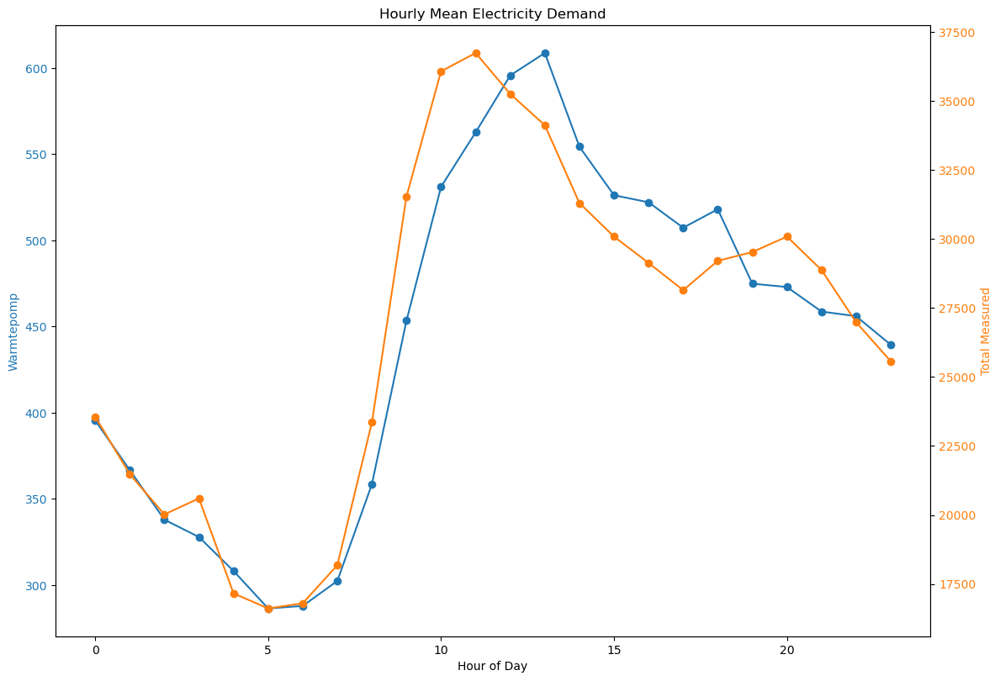

In [30]:
fig, ax1 = plt.subplots(figsize=(12, 8))

color = 'tab:blue'
ax1.set_xlabel('Hour of Day')
ax1.set_ylabel('Warmtepomp', color=color)
ax1.plot(hourly_demand.index, hourly_demand['Warmtepomp'], color=color, marker='o')
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  
color = 'tab:orange'
ax2.set_ylabel('Total Measured', color=color)  
ax2.plot(hourly_demand.index, hourly_demand['Total measured'], color=color, marker='o')
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  
plt.title('Hourly Mean Electricity Demand')
plt.show()


In [31]:
daily_demand = electric_power_df3.groupby('day_of_week')[['Warmtepomp', 'Total measured']].mean()
daily_demand

,Warmtepomp,Total measured
day_of_week,,
Friday,466.538732,28047.296334
Monday,493.985581,28544.369531
Saturday,406.681821,24058.141628
Sunday,399.375208,23942.142342
Thursday,448.236218,28330.896695
Tuesday,445.938503,27388.820135
Wednesday,445.786414,26431.242107


In [32]:
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
daily_demand = daily_demand.reindex(day_order)


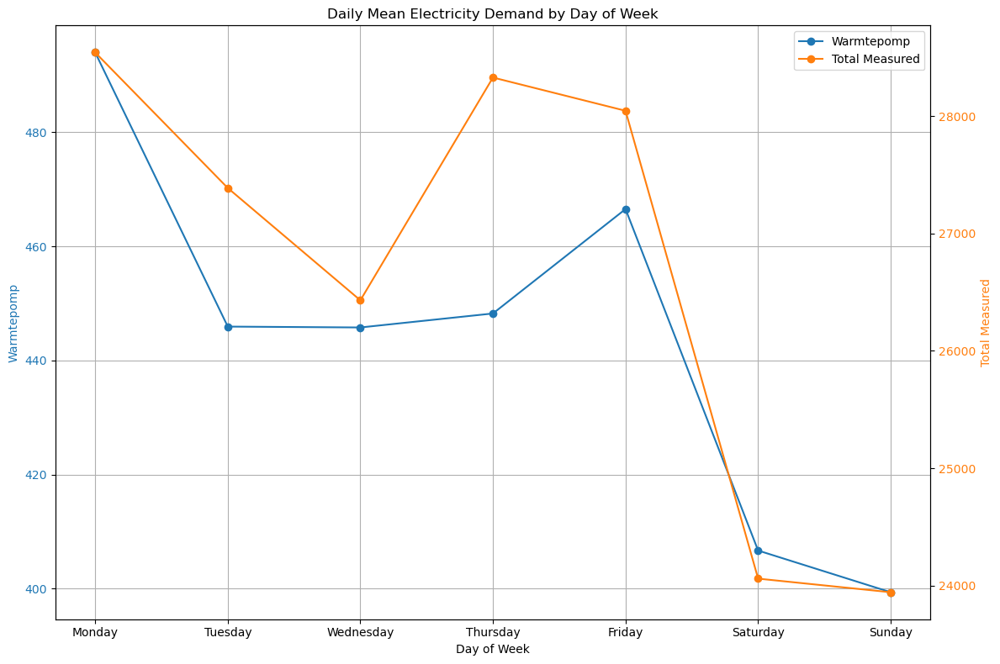

In [33]:
fig, ax1 = plt.subplots(figsize=(12, 8))

color = 'tab:blue'
ax1.set_xlabel('Day of Week')
ax1.set_ylabel('Warmtepomp', color=color)
ax1.plot(daily_demand.index, daily_demand['Warmtepomp'], color=color, marker='o', label='Warmtepomp')  
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  
color = 'tab:orange'
ax2.set_ylabel('Total Measured', color=color)
ax2.plot(daily_demand.index, daily_demand['Total measured'], color=color, marker='o', label='Total Measured')  
ax2.tick_params(axis='y', labelcolor=color)

plt.title('Daily Mean Electricity Demand by Day of Week')
fig.tight_layout()  
ax1.grid(True)

lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='upper right')

plt.show()


In [34]:
# Group by week of year and calculate mean electricity demand
weekly_demand = electric_power_df3.groupby(electric_power_df3['Time'].dt.isocalendar().week)[['Warmtepomp', 'Total measured']].mean()


# Group by month and calculate mean electricity demand
monthly_demand = electric_power_df3.groupby(electric_power_df3['Time'].dt.to_period('M'))[['Warmtepomp', 'Total measured']].mean()



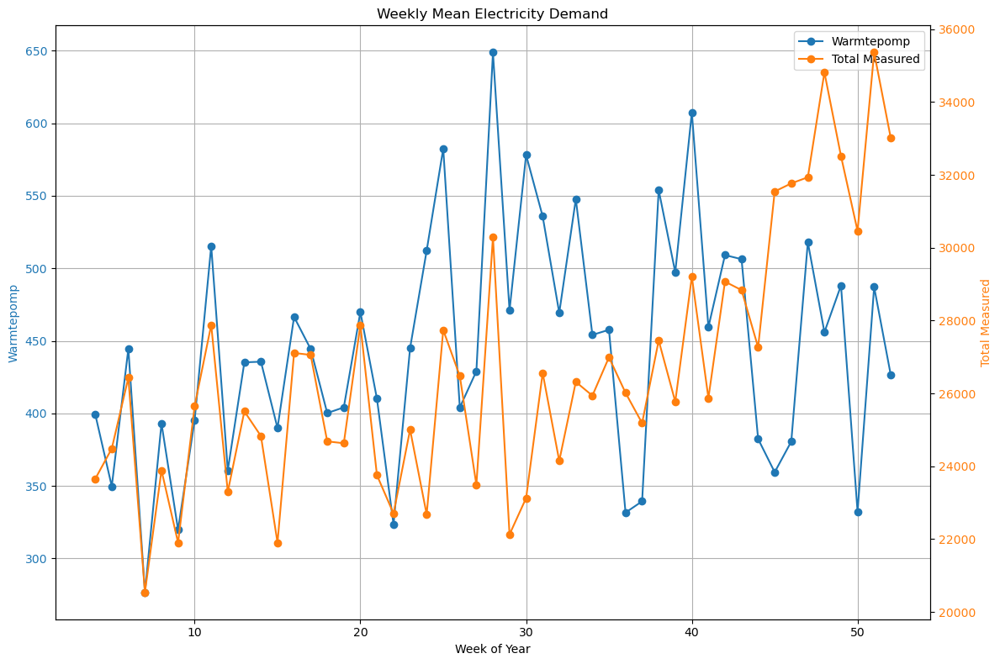

In [35]:
fig, ax1 = plt.subplots(figsize=(12, 8))

color = 'tab:blue'
ax1.set_xlabel('Week of Year')
ax1.set_ylabel('Warmtepomp', color=color)
ax1.plot(weekly_demand.index, weekly_demand['Warmtepomp'], color=color, marker='o', label='Warmtepomp')  # Plotting Warmtepomp
ax1.tick_params(axis='y', labelcolor=color)
ax1.set_title('Weekly Mean Electricity Demand')
ax1.grid(True)

ax2 = ax1.twinx()
color = 'tab:orange'
ax2.set_ylabel('Total Measured', color=color)
ax2.plot(weekly_demand.index, weekly_demand['Total measured'], color=color, marker='o', label='Total Measured')  # Plotting Total Measured
ax2.tick_params(axis='y', labelcolor=color)

lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='best')

plt.tight_layout()
plt.show()


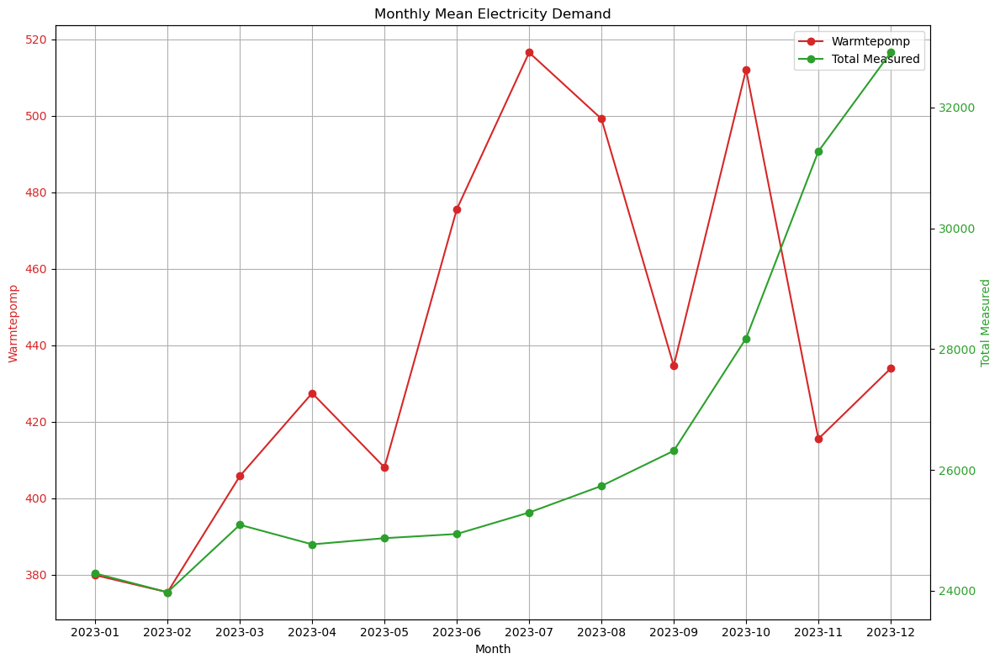

In [36]:
# Monthly Demand Plot

monthly_demand.index = monthly_demand.index.astype(str)

fig, ax1 = plt.subplots(figsize=(12, 8))

color = 'tab:red'
ax1.set_xlabel('Month')
ax1.set_ylabel('Warmtepomp', color=color)
ax1.plot(monthly_demand.index, monthly_demand['Warmtepomp'], color=color, marker='o', label='Warmtepomp')  # Plotting Warmtepomp
ax1.tick_params(axis='y', labelcolor=color)
ax1.set_title('Monthly Mean Electricity Demand')
ax1.grid(True)

ax2 = ax1.twinx()
color = 'tab:green'
ax2.set_ylabel('Total Measured', color=color)
ax2.plot(monthly_demand.index, monthly_demand['Total measured'], color=color, marker='o', label='Total Measured')  # Plotting Total Measured
ax2.tick_params(axis='y', labelcolor=color)

lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='best')

plt.tight_layout()
plt.show()


# modeling

In [37]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold, cross_val_score
import numpy as np



In [38]:
encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False ,drop='first')

In [39]:
encoded_features = pd.DataFrame(encoder.fit_transform(electric_power_df2[['hour', 'day_of_week', 'is_weekend', 'month', 'season']]),
                               columns=encoder.get_feature_names_out(['hour', 'day_of_week', 'is_weekend', 'month', 'season']))
encoded_features = encoded_features.reset_index(drop=True)
encoded_features

,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,...,month_6,month_7,month_8,month_9,month_10,month_11,month_12,season_Spring,season_Summer,season_Winter
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30776,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30777,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30778,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30779,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [40]:
electric_power_df2_encoded = pd.concat([electric_power_df2.drop(columns=['hour', 'day_of_week', 'is_weekend', 'month', 'season']).reset_index(drop=True), encoded_features], axis=1)
electric_power_df2_encoded

,Warmtenet,Warmtepomp,Waterzuivering,Vacuum,Laadpalen,Overig,Total measured,prev_day_demand,rolling_mean_3h,rolling_mean_7d,...,month_6,month_7,month_8,month_9,month_10,month_11,month_12,season_Spring,season_Summer,season_Winter
0,1926.667,200.000,11033.333,873.333,0.0,593.333,17726.667,27866.667,16814.444333,26853.488580,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1926.667,206.667,11293.333,1426.667,0.0,593.333,18686.667,12560.000,17078.888833,26841.216756,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,1926.667,200.000,10760.000,860.000,0.0,500.000,17586.667,11660.000,17305.555500,26830.819932,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,1926.667,200.000,11133.333,860.000,0.0,566.667,18080.000,12606.667,17504.444417,26819.183027,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,1926.667,200.000,11020.000,1453.333,0.0,320.000,18326.667,13053.333,17698.888917,26800.373503,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30776,1646.667,200.000,12033.333,1153.333,0.0,173.333,17760.000,33640.000,39934.444500,35168.886408,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30777,1640.000,200.000,12273.333,880.000,0.0,206.667,17793.333,32240.000,34275.000000,35172.487598,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30778,1626.667,200.000,11940.000,1133.333,0.0,226.667,17700.000,30706.667,29161.111083,35175.562996,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30779,1653.333,200.000,11733.333,753.333,0.0,213.333,17073.333,30346.667,26323.888833,35177.437996,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [41]:
# Split the data into X,y
X = electric_power_df2_encoded.drop(columns=['Total measured'])
y = electric_power_df2_encoded['Total measured']

display(X,y)

,Warmtenet,Warmtepomp,Waterzuivering,Vacuum,Laadpalen,Overig,prev_day_demand,rolling_mean_3h,rolling_mean_7d,hour_1,...,month_6,month_7,month_8,month_9,month_10,month_11,month_12,season_Spring,season_Summer,season_Winter
0,1926.667,200.000,11033.333,873.333,0.0,593.333,27866.667,16814.444333,26853.488580,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1926.667,206.667,11293.333,1426.667,0.0,593.333,12560.000,17078.888833,26841.216756,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,1926.667,200.000,10760.000,860.000,0.0,500.000,11660.000,17305.555500,26830.819932,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,1926.667,200.000,11133.333,860.000,0.0,566.667,12606.667,17504.444417,26819.183027,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,1926.667,200.000,11020.000,1453.333,0.0,320.000,13053.333,17698.888917,26800.373503,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30776,1646.667,200.000,12033.333,1153.333,0.0,173.333,33640.000,39934.444500,35168.886408,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30777,1640.000,200.000,12273.333,880.000,0.0,206.667,32240.000,34275.000000,35172.487598,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30778,1626.667,200.000,11940.000,1133.333,0.0,226.667,30706.667,29161.111083,35175.562996,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
30779,1653.333,200.000,11733.333,753.333,0.0,213.333,30346.667,26323.888833,35177.437996,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


0        17726.667
1        18686.667
2        17586.667
3        18080.000
4        18326.667
           ...    
30776    17760.000
30777    17793.333
30778    17700.000
30779    17073.333
30780    18353.333
Name: Total measured, Length: 30781, dtype: float64

In [42]:
# Split the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [57]:
#training the model


model = RandomForestRegressor(random_state=42)
model.fit(X_train, y_train)


RandomForestRegressor(random_state=42)

In [58]:
y_pred = model.predict(X_test)


In [59]:
#preformance of te test data


mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print("Mean Absolute Error (MAE): {:.2f}".format(mae))
print("Mean Squared Error (MSE): {:.2f}".format(mse))
print("Root Mean Squared Error (RMSE): {:.2f}".format(rmse))
print("R-squared (R²): {:.2f}".format(r2))


Mean Absolute Error (MAE): 1334.72
Mean Squared Error (MSE): 9660951.97
Root Mean Squared Error (RMSE): 3108.21
R-squared (R²): 0.95


# ANalysis

 -MAE tells us that, on average, our model's predictions are approximately 1334.72 units off from the actual values
 
 -The RMSE of 3108.21 is larger than the MAE, which highlights the presence of larger errors in our predictions
 
 -An R² of 0.95 is generally very high!

In [60]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(model, X, y, cv=5, scoring='neg_mean_squared_error')
rmse_scores = np.sqrt(-scores)  
# Using negative MSE because cross_val_score maximizes the utility function

print("Cross-validated RMSE scores:", rmse_scores)
print("Mean CV RMSE: {:.2f}".format(np.mean(rmse_scores)))
print("Standard Deviation in CV RMSE Scores: {:.2f}".format(np.std(rmse_scores)))



# from sklearn.model_selection import RepeatedKFold

# # Define the cross-validation method
# rkf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=42)

# # Compute the cross-validated RMSE
# scores = cross_val_score(model, X, y, cv=rkf, scoring='neg_mean_squared_error')
# rmse_scores = np.sqrt(-scores)

# print("Cross-validated RMSE scores:", rmse_scores)
# print("Mean CV RMSE: {:.2f}".format(np.mean(rmse_scores)))
# print("Standard Deviation in CV RMSE Scores: {:.2f}".format(np.std(rmse_scores)))


# ANalysis

-from around 2717.81 to 4642.13. This range indicates that the model’s performance can vary  depending on the training data

-The mean CV RMSE of 3806.70 is higher than the RMSE on test set. This indicates that the model performs well on the particular test set, its performance across other subsets of data (as simulated by cross-validation) shows more error.

-The standard deviation of 719.42 in the CV RMSE scores suggests a mid level of variability in the model's performance across different folds. This could be a sign of model overfitting on specific parts of the training data, or it could reflect intrinsic data variability that's hard to capture with a model.


In [53]:
# #training the model

# param_grid = {
#     'n_estimators': [100, 200, 300],
#     'max_depth': [None, 10, 20, 30],
#     'min_samples_split': [2, 5, 10]
# }

# rf = RandomForestRegressor(random_state=42)
# grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=3, n_jobs=-1, scoring='neg_mean_squared_error', verbose=2)
# grid_search.fit(X_train, y_train)
# print("Best parameters:", grid_search.best_params_)


Fitting 3 folds for each of 36 candidates, totalling 108 fits


KeyboardInterrupt: 

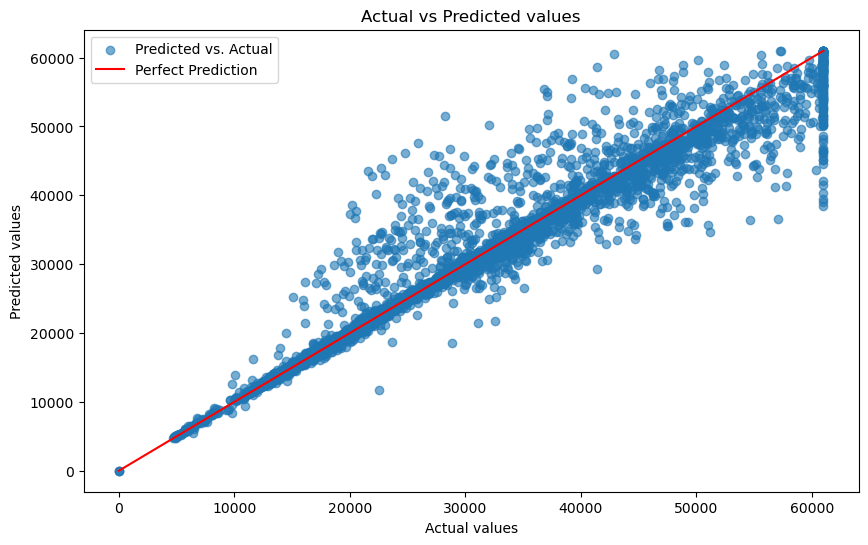

In [48]:
# Plotting Actual vs. Predicted values

plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.6, label='Predicted vs. Actual')  
plt.xlabel('Actual values')
plt.ylabel('Predicted values')
plt.title('Actual vs Predicted values')

plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', label='Perfect Prediction')

plt.legend()

# Show the plot
plt.show()

In [49]:
# Get feature importances
importances = model.feature_importances_
feature_importances = pd.DataFrame({'Feature': X.columns, 'Importance': importances}).sort_values(by='Importance', ascending=False)

print("\nFeature Importances:")
feature_importances.head(10)


Feature Importances:


,Feature,Importance
1,Warmtepomp,0.456286
4,Laadpalen,0.392531
2,Waterzuivering,0.070406
0,Warmtenet,0.020580
7,rolling_mean_3h,0.011234
3,Vacuum,0.010749
8,rolling_mean_7d,0.007497
6,prev_day_demand,0.005443
50,season_Spring,0.005196
5,Overig,0.005049


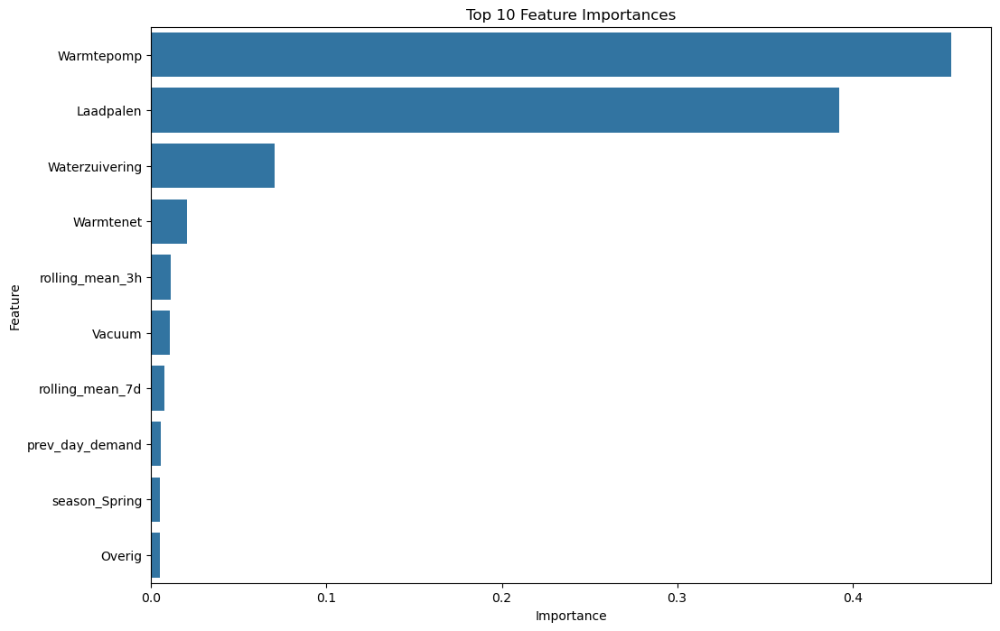

In [50]:

feature_importances = feature_importances.sort_values(by='Importance', ascending=False)

top_10_features = feature_importances.head(10)

plt.figure(figsize=(12, 8))
sns.barplot(x='Importance', y='Feature', data=top_10_features)
plt.title('Top 10 Feature Importances')
plt.show()

create 4 plots:

Hourly mean electricity demand for Warmtepomp and Total measured over a day.
Daily mean electricity demand for Warmtepomp and Total measured over a week.
Weekly mean electricity demand for Warmtepomp and Total measured over the year.
Monthly mean electricity demand for Warmtepomp and Total measured over the year.

In [51]:
Hourly Patterns:

Both heat pump and total electricity demand are lowest in the early morning hours (around 4-5 AM).
Demand for both increases throughout the morning, peaking in the late afternoon and evening (around 4-8 PM).
This pattern is consistent with typical daily household energy use, with higher demand during waking hours and lower demand overnight.
Daily Patterns:

Demand for both is lowest on weekends (Saturday and Sunday).
Demand is highest on weekdays, particularly Monday and Friday.
This suggests that heat pump use and overall electricity consumption are influenced by weekday activities.
Weekly Patterns:

There is a clear seasonal pattern in both heat pump and total electricity demand.
Demand is highest in the winter months (weeks 1-15 and 45-52).
Demand is lowest in the summer months (weeks 20-35).
This is expected, as heat pumps are primarily used for heating and are therefore in higher demand during colder periods.


Monthly Patterns:

The monthly pattern mirrors the weekly pattern, with the highest demand in December and January and the lowest in the summer months.
Overall, these patterns suggest that heat pump electricity demand and total electricity demand are influenced by time of day, day of the week, and season. These insights could be valuable for predicting future electricity demand and optimizing energy use.

The analysis of the charging stations electricity demand (Laadpalen) is not included here as all values in this column are 0.

SyntaxError: invalid syntax (2961016124.py, line 1)